# GDL: Equivariant graph neural networks

**Filled notebook:**
[![Open In Collab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1gJhyeQiK7dh2xN6gwVkpIhiTkBVwO9YV?usp=sharing)
**Authors:**
Putri van der Linden,
Rob Hesselink

## Introduction
The goal of this tutorial is to get you familiar with the ways in which positional information is used in graph neural networks. We will firstly look at superpixel MNIST, which groups pixels by similarity in order to create a graph. Then, we will apply steerable methods to MD17, a 3D dataset of molecular relaxation trajectories. 

This tutorial was created by Putri van der Linden and Rob Hesselink. If you would like to know more about these methods, feel free to contact us at

[r.d.hesselink@uva.nl](mailto:r.d.hesselink@uva.nl) \\
[p.a.vanderlinden@uva.nl](mailto:p.a.vanderlinden@uva.nl)

\\



Below you can find several papers that we recommend, if you're interested in some more reading. 

[Neural Message Passing for Quantum Chemistry](https://arxiv.org/pdf/1704.01212.pdf)

[Directional Message Passing for Molecular Graphs](https://arxiv.org/abs/2003.03123)

[E(3)-Equivariant Graph Neural Networks for Data-Efficient and Accurate Interatomic Potentials](https://arxiv.org/abs/2101.03164)







## 0. Graphs as objects embedded in Euclidean Space

Graph representations emerge in many machine learning domains; think for example about social networks, where users can represent nodes and edges can represent different types of interactions/relationships between them, or molecular property prediction, where atoms can be connected with eachother with various types of bonds, and the entire structure represents a molecule that, depending on the state/positions of the atoms, can emit different properties.

In social network graphs, the data is purely described in terms of node types and their connections to other nodes, but there is no notion of "position" for each node. 

However, there are some domains where there actually is some positional structure between nodes, and we would do best to make use of that structure when building our models. Think for example about molecules, where the relative positions of atoms to each other carry a lot of information about the properties of the molecule. Likewise, in the point cloud example, the task is defined by the positions of the nodes in $\mathbb{R}^3$.

In this tutorial we are going to look at graph convolution methods that can act on graphs embedded in some Euclidean space, meaning that the graph represents some n-dimensional structure, and we will refer to it as a **Geometric Graph**.


**Geometric Graphs**: A geometric graph $G=(\mathcal{V,E,X})$ is defined by a set of vertices $\mathcal{V}$ and a set of edges $E$, where the vertices are objects in a geometric space $\mathcal{X}$ and the edges represent some relationship between these points or objects. A multi-channel feature map $g_v:\mathcal{V} \rightarrow \mathbb{R}^{C_v}$ assigns a $C_v$-dimensional feature vector to each $v \in \mathcal{V}$ and a multi-channel feature map $g_e: E \rightarrow \mathbb{R}^{C_e}$ generates attribute $a_{ij}$ for each edge $e \in E$. Thus, we can use both node feature $f_i \in \mathbb{R}^{C_v}$ and the node position $x_i \in \mathcal{X}$ to describe node $v_i$. Each edge $e_{ij}$ can be described by its attribute $a_{ij} \in \mathbb{R}^{C_e}$.

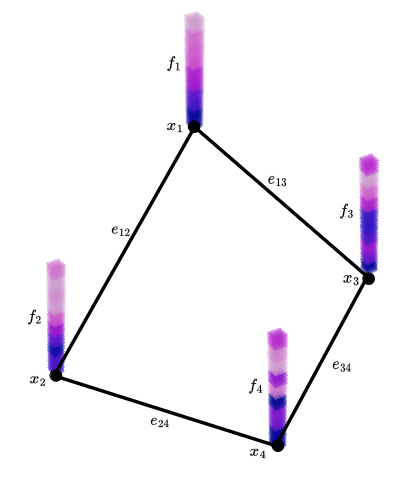

## 1. Message Passing Neural Networks

(In the current section we will follow the message passing framework as introduced in
[Neural Message Passing for Quantum Chemistry](https://arxiv.org/pdf/1704.01212.pdf).)

ConvNets proved to be of great importance in image processing due to the fact that they explicitly incorporate structural symmetries of the domain (i.e. translation equivariance). Likewise, in graphs we need to be aware of such symmetries, which in this case is invariance to graph isomorphisms. That is, graphs that share the same connectivity are considered equivalent. See the following for an example:



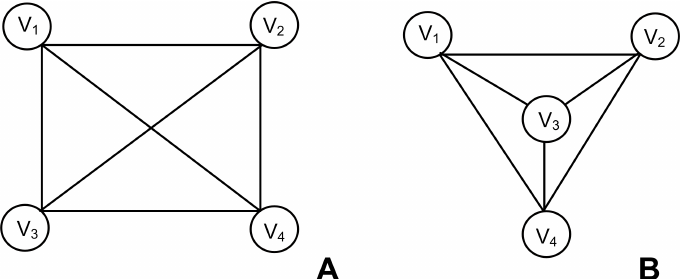

(image from: https://www.researchgate.net/publication/51083566_Using_graph_theory_to_analyze_biological_networks)

To this end we will be looking at a general MPNN framework, which respects this assumption on the domain, and look at various flavours that respect the geometry of the object at hand to different extents. Let us first consider the general MPNN framework, of which the forward pass consists of two phases: 

*  **the message passing phase**: In this phase *local* representations are built on the nodes based on neighbourhoods through the graph connectivity. These local representations are built on the nodes by propagating messages from neighbouring nodes in the following fashion:

$$ \begin{align*}
 m_{ij} &= \phi_e(f_i^l, f_j^l, a_{ij}) \quad{\text{Construct messages from neighbour nodes $j$ to center node $i$ (build edge representations)}}\\
 m_i &=  \sum_{j \in \mathcal{N}(i)} m_{ij}  \quad{\text{permutation invariant aggregation of the neighbour messages}}\\
f_i^{l+1} &= \phi_f(f_i^l, m_i)  \quad{\text{Update the center node representation based on the aggregated messages}}\end{align*}
$$

$\phi_e$ and $\phi_f$ are differentiable edge embedding and node embedding functions, respectively. $a_{ij}$ can contain additional edge attributes. By composing multiple of such operators, node representations can be built that can aggregate information over increasingly larger hop neighbourhoods.


*  **the readout phase**: constructs a *global* representation based on the all the nodes in graph after the final message passing step at $t$. This phase needs to be invariant to node permutations in order to ensure invariance to graph isomorphism. 

$$\begin{align*}
\hat{y} &= R(\{f^t_v| v \in V\})
\end{align*}$$

Where $R$ is usually some pooling (i.e. mean, max, add) on all the nodes.



### **1.2. PyTorch Geometric Recap: Deep learning for graph processing**

In this tutorial we are going to use Pytorch Geometric (PyG) to implement the message passing modules. Let's first do a quick recap on how to represent graphs in PyG. Assume we have the following (undirected) graph on the left. Its PyG representation will consist of 2d-arrays as is shown on the right. The ordering/indexing of the nodes along the rows in x and pos is tied to all node attributes, and the edge_index represents the row index of the source node in its first column to the index of the target node in its second. Similarly, the graph could be extended with edge attributes, where the indexing of the edge_index array is tied to an edge attribute array.



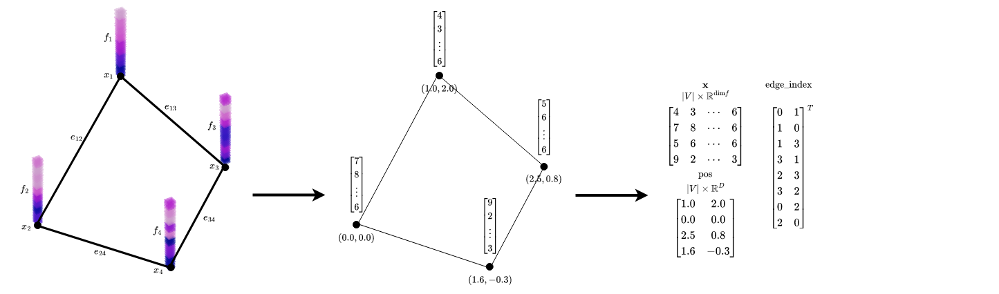

For a more extensive readup on how to represent graphs in PyG, we recommend [the official PyG docs](https://pytorch-geometric.readthedocs.io/en/latest/notes/introduction.html) and [this UvA DLC reference](https://uvadlc-notebooks.readthedocs.io/en/latest/tutorial_notebooks/tutorial7/GNN_overview.html#PyTorch-Geometric).

#### Let's look at Message passing in Torch Geometric
First install and import the relevant packages:

In [ ]:
!pip install torch==2.0.0+cu117 torchvision==0.15.1+cu117 torchaudio==2.0.1 --index-url https://download.pytorch.org/whl/cu117
import torch

def format_pytorch_version(version):
  return version.split('+')[0]

TORCH_version = torch.__version__
TORCH = format_pytorch_version(TORCH_version)

def format_cuda_version(version):
  return 'cu' + version.replace('.', '')

CUDA_version = torch.version.cuda
CUDA = format_cuda_version(CUDA_version)

Looking in indexes: https://download.pytorch.org/whl/cu117, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 GB 495.2 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 103.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 98.0 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 2.0.1+cu118
    Uninstalling torch-2.0.1+cu118:
      Successfully uninstalled torch-2.0.1+cu118
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.15.2+cu118
    Uninstalling torchvision-0.15.2+cu118:
      Successfully uninstalled torchvision-0.15.2+cu118
  Attempting uninstall: torchaudio
    Found existing installation: torchaudio 2.0.2+cu118
    Uninstalling torchaudio-2.0.2+cu118:
      Successfully uninstalled torchaudio-2.0.2+cu118
ERROR: pip's dependency resolver does not currently take into account all the packages that are instal

In [ ]:
# Let's install!
!pip install torch-scatter     -f https://pytorch-geometric.com/whl/torch-{TORCH}+{CUDA}.html
!pip install torch-sparse      -f https://pytorch-geometric.com/whl/torch-{TORCH}+{CUDA}.html 
!pip install torch-cluster     -f https://pytorch-geometric.com/whl/torch-{TORCH}+{CUDA}.html
!pip install torch-spline-conv -f https://pytorch-geometric.com/whl/torch-{TORCH}+{CUDA}.html
!pip install torch-geometric
!pip install pytorch_lightning
!pip install e3nn
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://pytorch-geometric.com/whl/torch-2.0.0+cu117.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 35.8 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://pytorch-geometric.com/whl/torch-2.0.0+cu117.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 21.0 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://pytorch-geometric.com/whl/torch-2.0.0+cu117.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 18.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://pytorch-geometric.com/whl/torch-2.0.0+cu117.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 885.5/885.5 kB 17.3 M

In [ ]:
# Import the most important things
%matplotlib inline
import math
import numpy as np
import networkx
import matplotlib.pyplot as plt
import pytorch_lightning as pl
import torchmetrics
import torch
import torch.nn as nn
import torch.nn.functional as F
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from e3nn import o3
from e3nn.o3 import Irreps
from e3nn.nn import Gate
from torch_scatter import scatter_mean
import io
import PIL

from torch_geometric.nn import MessagePassing, global_add_pool, global_mean_pool
from torch_geometric.datasets import MD17
from torch_geometric.transforms import RadiusGraph, Compose, BaseTransform, Distance, Cartesian, RandomRotate
from torch_geometric.loader import DataLoader

from tqdm import tqdm

import torch_geometric as tg
import networkx as nx
import torchvision

import os

pl.seed_everything(42, workers=True)

INFO:lightning_fabric.utilities.seed:Global seed set to 42


42

## Message Passing in PyG

You can see an implementation of the model in 1.0 in the code block below. We use Pytorch Geometric to realise these models, which greatly simplifies the implementation by doing the necessary scattering and aggregating in the background. The functions $\phi_e$ and $\phi_f$ are implemented by one layer MLPs, which are sufficient for solving the problems we'll deal with today. 

In [ ]:
class MPNNLayer(MessagePassing):
    """ Message Passing Layer """
    def __init__(self, node_features, edge_features, hidden_features, out_features, aggr="mean", act=nn.ReLU, pool=global_add_pool):
        super().__init__(aggr=aggr)

        self.message_net = nn.Sequential(nn.Linear(2 * node_features + edge_features, hidden_features),
                                         act(),
                                         nn.Linear(hidden_features, hidden_features))
    
        self.update_net = nn.Sequential(nn.Linear(node_features + hidden_features, hidden_features),
                                        act(),
                                        nn.Linear(hidden_features, out_features))
    

    def forward(self, x, edge_index, edge_attr=None):
        x = self.propagate(edge_index, x=x, edge_attr=edge_attr)
        return x

    def message(self, x_i, x_j, edge_attr):
        """ Construct messages between nodes """
        input = [x_i, x_j] if edge_attr is None else [x_i, x_j, edge_attr]
        input = torch.cat(input, dim=-1)
        message = self.message_net(input)
        return message

    def update(self, message, x):
        """ Update node features """
        input = torch.cat((x, message), dim=-1)
        update = self.update_net(input)
        return update


class MPNN(nn.Module):
    """ Message Passing Neural Network """
    def __init__(self, node_features, edge_features, hidden_features, out_features, num_layers, aggr="mean", act=nn.ReLU, pool=global_add_pool):
        """
        Here we choose global_add_pool as our default graph pooling methods,
        but with the other type of tasks, make sure to try also pooling methods like [global_max_pool, global_mean_pool]
        to make your network have specific features.
        """
        super().__init__()

        self.embedder = nn.Sequential(nn.Linear(node_features, hidden_features),
                                      act(),
                                      nn.Linear(hidden_features, hidden_features))


        layers = []
        for i in range(num_layers):
            layer = MPNNLayer(node_features=hidden_features,
                            hidden_features=hidden_features,
                            edge_features=edge_features,
                            out_features=hidden_features,
                            aggr=aggr,
                            act=act,
                            pool=pool
                              )
            layers.append(layer)
        self.layers = nn.ModuleList(layers)

        self.pooler = pool

        self.head = nn.Sequential(nn.Linear(hidden_features, hidden_features),
                                  act(),
                                  nn.Linear(hidden_features, out_features))

    def forward(self, x, edge_index, batch, edge_attr=None):
        x = self.embedder(x)

        for layer in self.layers:
            x = layer(x, edge_index, edge_attr) 
        
        if self.pooler:
            x = self.pooler(x, batch)
        
        x = self.head(x)
        return x


    def get_pre_pool_rep(self, x, edge_index, edge_attr=None):
        """
        To get the node representations before pooling each graph to one representation.
        We will use this function to examine the equivariance of the models in the later part of the tutorial.
        """
        with torch.no_grad():            
            x = self.embedder(x)

            for layer in self.layers:
                x = layer(x, edge_index, edge_attr)
        
        return x


## 2. 2D Data: Superpixel MNIST

Superpixel MNIST contains 2D graph representations where nodes correspond to the centers of superpixel patches (pixels grouped together according to similarity) and edges with maximum length 8. We will do graph classification on this dataset.

The message passing scheme as described in 2 does not explicitly take the geometric structure between the nodes into account; they act only on the feature vectors $f_i$ on the nodes, but not their position (that is, any structure between their position vectors $x_i$). For example, the current MPNN scheme is invariant to rotations and distance between nodes,
and hence immediately discards this information when building the node representations.

We will build node representation that respect the geometry of the manifold on which the graph lives. We will do this by injecting various geometric quantities into the edge embeddings, for example the distance between nodes, or their relative position. These choices are invariant/equivariant with respect to different groups and we will vary the input to explore how feature vectors transform under rotations. 

In [ ]:
if not os.path.exists("./datasets"):
    os.mkdir("./datasets")

batch_size = 64
radius = 8


# Regular dataloaders
transforms = RadiusGraph(radius)
train_set = tg.datasets.MNISTSuperpixels(root='./datasets', transform=transforms, train=True)
val_set = tg.datasets.MNISTSuperpixels(root='./datasets', transform=transforms, train=False)

train_loader = tg.loader.DataLoader(train_set, batch_size=batch_size, shuffle=False)
val_loader = tg.loader.DataLoader(val_set, batch_size=batch_size, shuffle=False) 


# Dataloaders with distance edge attributes
dist_transforms = Compose([RadiusGraph(radius), Distance()])
train_set_dist = tg.datasets.MNISTSuperpixels(root='./datasets', transform=dist_transforms, train=True)
val_set_dist = tg.datasets.MNISTSuperpixels(root='./datasets', transform=dist_transforms, train=False)

train_loader_dist = tg.loader.DataLoader(train_set_dist, batch_size=batch_size, shuffle=False)
val_loader_dist = tg.loader.DataLoader(val_set_dist, batch_size=batch_size, shuffle=False)


# Dataloaders with relative position edge attributes
relpos_transforms = Compose([RadiusGraph(radius), Cartesian()])
train_set_relpos = tg.datasets.MNISTSuperpixels(root='./datasets', transform=relpos_transforms, train=True)
val_set_relpos = tg.datasets.MNISTSuperpixels(root='./datasets', transform=relpos_transforms, train=False)

train_loader_relpos = tg.loader.DataLoader(train_set_relpos, batch_size=batch_size, shuffle=False)
val_loader_relpos = tg.loader.DataLoader(val_set_relpos, batch_size=batch_size, shuffle=False)

# image mnist for visualizations
train_set_regular = torchvision.datasets.MNIST(root='./datasets', train=True, transform=torchvision.transforms.Compose([torchvision.transforms.ToTensor()]), download=True)
val_set_regular = torchvision.datasets.MNIST(root='./datasets', train=False, transform=torchvision.transforms.Compose([torchvision.transforms.ToTensor()]), download=True)


print(train_set[0])
print(train_set_dist[0])
print(train_set_relpos[0])

Extracting datasets/raw/MNISTSuperpixels.zip
Processing...
Done!


100%|██████████| 9912422/9912422 [00:00<00:00, 158351689.92it/s]

Extracting ./datasets/MNIST/raw/train-images-idx3-ubyte.gz to ./datasets/MNIST/raw


100%|██████████| 28881/28881 [00:00<00:00, 12829452.85it/s]


Extracting ./datasets/MNIST/raw/train-labels-idx1-ubyte.gz to ./datasets/MNIST/raw



100%|██████████| 1648877/1648877 [00:00<00:00, 40494723.76it/s]

Extracting ./datasets/MNIST/raw/t10k-images-idx3-ubyte.gz to ./datasets/MNIST/raw




100%|██████████| 4542/4542 [00:00<00:00, 18441944.60it/s]


Extracting ./datasets/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./datasets/MNIST/raw

Data(x=[75, 1], edge_index=[2, 1198], y=[1], pos=[75, 2])
Data(x=[75, 1], edge_index=[2, 1198], y=[1], pos=[75, 2], edge_attr=[1198, 1])
Data(x=[75, 1], edge_index=[2, 1198], y=[1], pos=[75, 2], edge_attr=[1198, 2])


 Here we can see what a datasample looks like (original image is plotted underneath):

Digit: 4


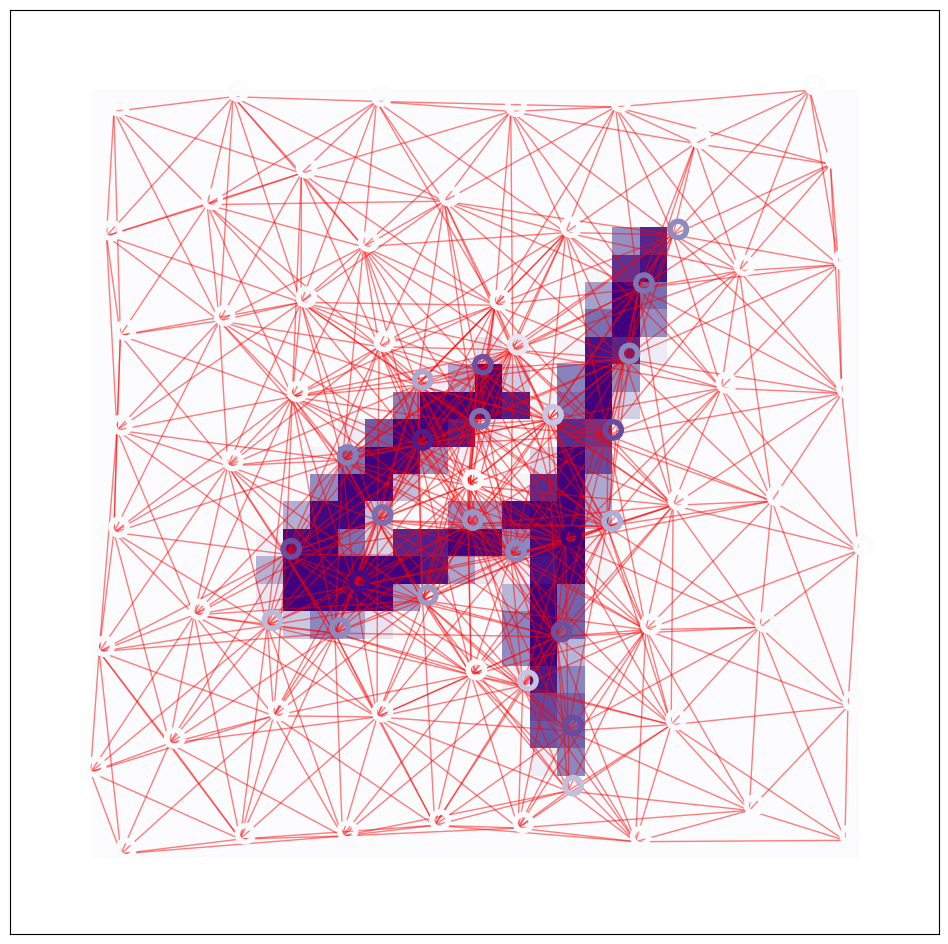

In [ ]:
def visualize_sample(idx, data, regular_data):

    
    sample_graph = data[idx].clone()
    sample_graph.pos -= sample_graph.pos.min()
    sample_graph.pos = sample_graph.pos/sample_graph.pos.max() * 2 - 1
    
    
    sample_mnist = regular_data[idx][0].squeeze(0)

    pos_dict = {}
    print(f"Digit: {sample_graph.y.item()}")
    for i, p in enumerate(sample_graph.pos):
        pos_dict[i] = p.numpy() * np.array([1, -1])

    
    g = tg.utils.to_networkx(sample_graph, to_undirected=True)

    f, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(sample_mnist.numpy(), extent=[-1,1,-1,1], cmap='Purples')
    nx.draw_networkx_nodes(g, 
                           node_size=500, 
                           node_color=sample_graph.x.cpu().numpy(), 
                           node_shape=r'$\circ$', 
                           pos=pos_dict,
                           cmap='Purples')

    nx.draw_networkx_edges(g, edge_color='r', alpha=0.5, pos=pos_dict)

visualize_sample(np.random.randint(len(train_set)), train_set, train_set_regular)


Recall that for batch processing of N graphs, PyG builds a single composite graph where the N graphs are disconnected. Hence, the batch element assigns to each node the index of which of the N graphs it belongs to.



In [ ]:
for graphs in train_loader:
    print(f"batch_shape: {graphs.batch.shape}")
    print(f"batch_size: {graphs.batch.max() + 1}")
    # the first graph has 75 nodes: hence the batch attribute assigns the first 75 nodes to the 0th graph
    print(graphs.batch[:76])
    break

batch_shape: torch.Size([4800])
batch_size: 64
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 1])


In the following we will train the MPNNs with three types of edge embeddings: 


*   No edge attributes
*   Euclidean distance
*   Relative distance vector

In [ ]:
class MNISTClassifier(pl.LightningModule):
    def __init__(self, model, lr, **kwargs):
        super().__init__(**kwargs)
        self.model = model
        self.lr = lr
        
        self.train_metric = torchmetrics.Accuracy(task="multiclass", num_classes=10)
        self.valid_metric = torchmetrics.Accuracy(task="multiclass", num_classes=10)

    def forward(self, graph):
        if isinstance(self.model, MPNN):
            return self.model(x=graph.x, edge_index=graph.edge_index, edge_attr=graph.edge_attr, batch=graph.batch)
        elif isinstance(self.model, EGNN):
            return self.model(x=graph.x, pos=graph.pos, edge_index=graph.edge_index, batch=graph.batch)
    
    def training_step(self, graph):
        pred = self(graph).squeeze()
        loss = F.cross_entropy(pred, graph.y)
        self.train_metric(pred, graph.y)
        return loss
    
    def on_train_epoch_end(self):
        self.log("train acc", self.train_metric, prog_bar=True)
    
    def validation_step(self, graph, batch_idx):
        pred = self(graph).squeeze()
        self.valid_metric(pred, graph.y)
    
    def on_validation_epoch_end(self):
        self.log("valid acc", self.valid_metric, prog_bar=True)
    
    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)

## 3. Training of MPNN, Distance MPNN and RelPos MPNN

You can train these models yourself, or load from checkpoints which you can download [here](https://drive.google.com/drive/folders/1OJrpdojGTALIcxNqVkch241lQC-rrG6c?usp=sharing).

In [ ]:
n_epochs = 51
learning_rate = 1e-3
batch_size = 64

node_features = 1
hidden_features = 64
out_features = 10
num_layers = 2
pooling = global_add_pool

In [ ]:
vanilla_mpnn = MPNN(node_features=node_features, 
                    edge_features=0,
                    hidden_features=hidden_features, 
                    out_features=out_features, 
                    num_layers=num_layers,
                    pool=pooling,)
                    

trainer_mpnn = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
# trainer_mpnn.fit(model=MNISTClassifier(model=vanilla_mpnn, lr=learning_rate), train_dataloaders=train_loader, val_dataloaders=val_loader)
# trainer_mpnn.save_checkpoint("./vanilla_mpnn.ckpt")

# Use this for loading from a checkpoint
trainer_mpnn.fit(model=MNISTClassifier(model=vanilla_mpnn, lr=learning_rate), train_dataloaders=train_loader, val_dataloaders=val_loader, ckpt_path="./vanilla_mpnn.ckpt")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./vanilla_mpnn.ckpt
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:337: UserWarning: The dirpath has changed from '/content/lightning_logs/version_0/checkpoints' to '/content/lightning_logs/version_3/checkpoints', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
  warnings.warn(
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Ty

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [ ]:
dist_mpnn = MPNN(node_features=node_features, 
                 edge_features=1,
                 hidden_features=hidden_features, 
                 out_features=out_features, 
                 num_layers=num_layers,
                 pool=pooling,)

trainer_dist = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
# trainer_dist.fit(model=MNISTClassifier(model=dist_mpnn, lr=learning_rate), train_dataloaders=train_loader_dist, val_dataloaders=val_loader_dist)
# trainer_dist.save_checkpoint("./dist_mpnn.ckpt")

# Use this for loading from a checkpoint
trainer_dist.fit(model=MNISTClassifier(model=dist_mpnn, lr=learning_rate), train_dataloaders=train_loader_dist, val_dataloaders=val_loader_dist, ckpt_path="./dist_mpnn.ckpt")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./dist_mpnn.ckpt
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:337: UserWarning: The dirpath has changed from '/content/lightning_logs/version_1/checkpoints' to '/content/lightning_logs/version_4/checkpoints', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
  warnings.warn(
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [ ]:
relpos_mpnn = MPNN(node_features=node_features, 
                   edge_features=2,
                   hidden_features=hidden_features, 
                   out_features=out_features, 
                   num_layers=num_layers,
                   pool=pooling,)

trainer_relpos = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
# trainer_relpos.fit(model=MNISTClassifier(model=relpos_mpnn, lr=learning_rate), train_dataloaders=train_loader_relpos, val_dataloaders=val_loader_relpos)
# trainer_relpos.save_checkpoint("./relpos_mpnn.ckpt")

# Use this for loading from a checkpoint
trainer_relpos.fit(model=MNISTClassifier(model=relpos_mpnn, lr=learning_rate), train_dataloaders=train_loader_relpos, val_dataloaders=val_loader_relpos, ckpt_path="./relpos_mpnn.ckpt")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./relpos_mpnn.ckpt
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:337: UserWarning: The dirpath has changed from '/content/lightning_logs/version_2/checkpoints' to '/content/lightning_logs/version_5/checkpoints', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
  warnings.warn(
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Typ

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Exception ignored in: <function Profiler.__del__ at 0x7f6b92384820>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pytorch_lightning/profilers/profiler.py", line 144, in __del__
    def __del__(self) -> None:
KeyboardInterrupt: 
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


### 3.2 Lets visualize the learned representations under rotations

We will now look at what the representations learned after the message passing phase look like (pre-pooling) when we apply different rotations to the input. Specifically, at each node we will look at the values of the first three learned features.

In [ ]:
#@title (This cell contains some code for creating visualizations, feel free to skip over it)
import cv2
import PIL



# helper code for visualizing
def visualize_rep(pos, x, edges, ax=None):
    pos_dict = {}
    for i, p in enumerate(pos):

        pos_dict[i] = p.cpu().numpy() * np.array([1, -1])

    for i in range(x.shape[-1]):
        data = tg.data.Data(pos=pos, x=x[:, i], edge_index=edges)
        g = tg.utils.to_networkx(data, to_undirected=True)

        if i > 0:
            for key, val in pos_dict.items():
                pos_dict[key] = val + np.array([0, 0.07])
        nx.draw_networkx_nodes(g,
                               node_size=300, 
                               node_color=data.x.cpu().numpy(), 
                               node_shape=r's', 
                               ax=ax,
                               pos=pos_dict)

    nx.draw_networkx_edges(g, edge_color='r', ax=ax, alpha=0.5, pos=pos_dict)
    
    return ax

class RotateDegree(tg.transforms.RandomRotate):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    def __call__(self, data, degree):
        
        degree = math.pi * degree / 180.0
        
        sin, cos = math.sin(degree), math.cos(degree)

        if data.pos.size(-1) == 2:
            matrix = [[cos, sin], [-sin, cos]]
        else:
            if self.axis == 0:
                matrix = [[1, 0, 0], [0, cos, sin], [0, -sin, cos]]
            elif self.axis == 1:
                matrix = [[cos, 0, -sin], [0, 1, 0], [sin, 0, cos]]
            else:
                matrix = [[cos, sin, 0], [-sin, cos, 0], [0, 0, 1]]

        
        return tg.transforms.LinearTransformation(torch.tensor(matrix))(data)


def visualize_sample_transformed(sample_graph, sample_mnist, ax=None):
    pos_dict = {}
    for i, p in enumerate(sample_graph.pos):
        pos_dict[i] = p.numpy() * np.array([1, -1])

    h = sample_mnist.shape[0] / 28
    g = tg.utils.to_networkx(sample_graph, to_undirected=True)

    ax.imshow(sample_mnist, extent=[-1.0 * h, 1.0 * h, -1.0 * h, 1.0 * h])
    nx.draw_networkx_nodes(g, 
                           node_size=300, 
                           node_color=sample_graph.x.numpy(), 
                           node_shape=r'$\circ$', 
                           ax=ax,
                           pos=pos_dict)
    
    

    nx.draw_networkx_edges(g, edge_color='r', ax=ax, alpha=0.5, pos=pos_dict)
    return ax


def plot_rotated_representations(model, original_graph, mnist_img, rotations, video_name=None, connectivity_transform=None, edge_attr_transform=None):
    
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    if video_name is None:
        video_name = 'video.avi'
    
    if not os.path.exists("./img_temp"):
        os.mkdir("./img_temp")

    image_folder = f"./img_temp/{video_name.split('.')[0]}"
    if not os.path.exists(image_folder):
        os.mkdir(image_folder)
        
        
    if not os.path.exists(image_folder + "_stabilized"):
        os.mkdir(image_folder + "_stabilized")

    if connectivity_transform is not None:
        original_graph = connectivity_transform(original_graph)
        

    # rotating representations
    with torch.no_grad():
        for i, rot in enumerate(rotations):
            fig, axes = plt.subplots(1, 2, figsize=(14, 6), constrained_layout=True)

            # rotated view
            rot_graph = RotateDegree(degrees=180)(original_graph.clone(), degree=rot)
            
            if edge_attr_transform is not None:
                rot_graph = edge_attr_transform(rot_graph)
            rot_graph = tg.transforms.NormalizeScale()(rot_graph)

            sample_mnist = torchvision.transforms.ToPILImage()(mnist_img.clone())
            sample_mnist_rot = np.array(sample_mnist.rotate(rot))


            axes[0] = visualize_sample_transformed(rot_graph, sample_mnist_rot, axes[0])

            axes[0].set_title("input", fontsize=20)
            axes[0].set_aspect('equal', 'box')
            rot_graph = rot_graph.to(device)
            x, edge_index, pos, edge_attr = rot_graph.x, rot_graph.edge_index, rot_graph.pos, rot_graph.edge_attr

            x = model.get_pre_pool_rep(x=x, edge_index=edge_index, edge_attr=edge_attr)
            axes[1] = visualize_rep(pos=pos, x=x[:,:3], edges=edge_index, ax=axes[1])

        
            
            axes[1].set_aspect('equal', 'box')
            axes[1].set_title("pre-pool representation", fontsize=20)

    
            fig.suptitle(r"$\theta = "+ str(rot) + "^\circ$", fontsize=30)
    

            plt.savefig(f"{image_folder}/{i}.png", dpi=200)
            plt.close()
            
            fig, ax = plt.subplots(figsize=(8, 8), constrained_layout=True)
            
            # rotate back for stabilized view
            rot_graph = RotateDegree(degrees=180)(tg.data.Data(pos=pos, x=x, edge_index=edge_index).to(device), degree=-rot)
            rot_graph = tg.transforms.NormalizeScale()(rot_graph)

            x, edge_index, pos, edge_attr = rot_graph.x, rot_graph.edge_index, rot_graph.pos, rot_graph.edge_attr


            ax = visualize_rep(pos=pos, x=x[:,:3], edges=edge_index, ax=ax)
            
            ax.set_title("stabilized view", fontsize=20)
            
            fig.suptitle(r"$\theta = "+ str(rot) + "^\circ$", fontsize=30)
            plt.savefig(f"{image_folder}_stabilized/{i}.png", dpi=200)
            plt.close()


        images = list(range(len(rotations)))
        images = [str(i) + ".png" for i in images]

        frame = cv2.imread(os.path.join(image_folder, images[0]))
        height, width, layers = frame.shape

        video = cv2.VideoWriter(video_name, 0, 10.0, (width, height))

        for image in images:
            video.write(cv2.imread(os.path.join(image_folder, image)))

        cv2.destroyAllWindows()
        video.release()
        
        
        frame = cv2.imread(os.path.join(image_folder + "_stabilized", images[0]))
        height, width, layers = frame.shape

        video = cv2.VideoWriter("stabilized_" + video_name , 0, 10.0, (width, height))

        for image in images:
            video.write(cv2.imread(os.path.join(image_folder + "_stabilized", image)))

        cv2.destroyAllWindows()
        video.release()


In [ ]:
data_idx = 20
sample_mnist = train_set_regular[data_idx][0].squeeze(0)
original_graph = train_set[data_idx]
rot_ranges = list(np.linspace(0, 180, 90))


plot_rotated_representations(vanilla_mpnn, 
                             original_graph, 
                             sample_mnist, 
                             rot_ranges, 
                             "vanilla_mpnn.avi",
                             RadiusGraph(radius))

plot_rotated_representations(dist_mpnn, 
                             original_graph, 
                             sample_mnist, 
                             rot_ranges, 
                             "dist_mpnn.avi",
                             RadiusGraph(radius),
                             tg.transforms.Distance())

plot_rotated_representations(relpos_mpnn, 
                             original_graph, 
                             sample_mnist, 
                             rot_ranges, 
                             "relpos_mpnn.avi",
                             RadiusGraph(radius),
                             tg.transforms.Cartesian())

We have trained a few rotation-invariant models (the vanilla MPNN and the distance MPNN), and we indeed see that the message passing representations do not change under input rotations (the models see these all as the same object.) For the relative position MPNN, the representations do change, meaning that rotated inputs may be classified as different objects in the readout phase.

The results are expected. As the message passing layers of vanilla MPNN $m_{ij} = \phi_m (f_i, f_j)$ do not contain any geometric information of nodes, which is rotation invariant. The message passing layers of distance MPNN $m_{ij} = \phi_m(f_i, f_j, d_{ij})$ contain only the distance of node i and node j in the form of scalar $d_{ij} \in \mathbb{R}$, which is also rotation invariant as the representation of $SO(3)$ on scalar vector field $\mathbb{R}^n$ is trivial ($I_n = I \oplus I \oplus \dots \oplus I$). While message passing layers of relative position MPNN $ m_{ij} = \phi_m (f_i, f_j, x_j - x_i) $ is only translation invariant, which surely will generate different messages for the same set of nodes by applying different rotations to the graph.

### EGNN

Introduced in [E(n) Equivariant Graph Neural Networks](https://arxiv.org/abs/2102.09844), the EGNN is a computationally efficient equivariant graph neural network. It extends the message passing equations seen previously by updating node positions. 

\begin{align}
 m_{ij} &= \phi_e(f_i^l, f_j^l, ||x_i - x_j||)\\
 x^{l+1}_i &= x^l_i + \sum_{j \in \mathcal{N}(i)} (x^l_i - x^l_j) \phi_p(m_{ij}) \\
 m_i &=  \sum_{j \in \mathcal{N}(i)} m_{ij} \\
f_i^{l+1} &= \phi_f(f_i^l, m_i) 
\end{align}

The addition here is in line two, where $\phi_p$ produces a scalar that weights how much $x_i$ moves towards or away from its neighbours. You can check for yourself that this update rule is equivariant. Note, however, that $\phi_p(m_{ij})$ depends only on the distance and is therefore invariant. However, by moving nodes closer to each other, the EGNN may learn to re-weight the extent in which they influence each other, making the model more flexible than the previous MPNNs. 

Given that points can now move around, we will need to update the graph after every position update. The code below has been left partially empty as an exercise for the reader. Please implement the message and update methods `EGNNLayer`. Hint: we can aggregate the position updates together with the standard messages by concatenating them at the end of the `message` function. 

In [ ]:
class EGNNLayer(MessagePassing):
    """ E(n)-equivariant Message Passing Layer """
    def __init__(self, node_features, edge_features, hidden_features, out_features, dim, aggr, act):
        super().__init__(aggr=aggr)
        self.dim = dim

        self.message_net = nn.Sequential(nn.Linear(2 * node_features + edge_features, hidden_features),
                                         act(),
                                         nn.Linear(hidden_features, hidden_features))
    
        self.update_net = nn.Sequential(nn.Linear(node_features + hidden_features, hidden_features),
                                        act(),
                                        nn.Linear(hidden_features, out_features))
        
        self.pos_net = nn.Sequential(nn.Linear(hidden_features, hidden_features),
                                     act(),
                                     nn.Linear(hidden_features, 1))
        
        nn.init.xavier_uniform_(self.pos_net[-1].weight, gain=0.001)

    

    def forward(self, x, pos, edge_index, edge_attr=None):

        x = self.propagate(edge_index, x=x, pos=pos, edge_attr=edge_attr)
        return x

    def message(self, x_i, x_j, pos_i, pos_j, edge_attr):
        """ Create messages """
        input = [x_i, x_j] if edge_attr is None else [x_i, x_j, edge_attr]
        input = torch.cat(input, dim=-1)
        message = self.message_net(input)

        pos_message = (pos_i - pos_j)*self.pos_net(message)
        message = torch.cat((message, pos_message), dim=-1)
        return message

    def update(self, message, x, pos):
        """ Update node features and positions """
        node_message, pos_message = message[:, :-self.dim], message[:, -self.dim:]
        # Update node features
        input = torch.cat((x, node_message), dim=-1)
        update = self.update_net(input)
        # Update positions
        pos += pos_message
        return update, pos

class EGNN(nn.Module):
    """ E(n)-equivariant Message Passing Network """
    def __init__(self, node_features, hidden_features, out_features, num_layers, dim, radius, aggr="mean", act=nn.ReLU, pool=global_add_pool):
        super().__init__()
        edge_features = 1
        self.dim = dim
        self.radius = radius

        self.embedder = nn.Sequential(nn.Linear(node_features, hidden_features),
                                      act(),
                                      nn.Linear(hidden_features, hidden_features))
        
       
    
        layers = []
        for i in range(num_layers):
            layers.append(EGNNLayer(hidden_features, edge_features, hidden_features, hidden_features, dim, aggr, act))
        self.layers = nn.ModuleList(layers)

        self.pooler = pool

        self.head = nn.Sequential(nn.Linear(hidden_features, hidden_features),
                                  act(),
                                  nn.Linear(hidden_features, out_features))

    def forward(self, x, pos, edge_index, batch):
        x = self.embedder(x)

        dist = torch.sum((pos[edge_index[1]] - pos[edge_index[0]]).pow(2), dim=-1, keepdim=True).sqrt()
        edge_attr = dist
       
        for layer in self.layers:
            x, pos = layer(x, pos, edge_index, dist) 

            # Update graph
            if self.radius:
                edge_index = tg.nn.radius_graph(pos, self.radius, batch)
                dist = torch.sum((pos[edge_index[1]] - pos[edge_index[0]]).pow(2), dim=-1, keepdim=True).sqrt()
        
        if self.pooler:
            x = self.pooler(x, batch)
        
        x = self.head(x)
        return x

In [ ]:
egnn = EGNN(node_features=node_features, 
            hidden_features=hidden_features, 
            out_features=out_features, 
            num_layers=num_layers, 
            dim=2,
            radius=radius
            )


trainer_egnn = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
# trainer_egnn.fit(MNISTClassifier(model=egnn, lr=learning_rate), train_dataloaders=train_loader, val_dataloaders=val_loader)
# trainer_egnn.save_checkpoint("./egnn.ckpt")

# Use this for loading from a checkpoint
trainer_egnn.fit(model=MNISTClassifier(model=egnn, lr=learning_rate), train_dataloaders=train_loader, val_dataloaders=val_loader, ckpt_path="./egnn.ckpt")

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./egnn.ckpt
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:337: UserWarning: The dirpath has changed from '/content/lightning_logs/version_0/checkpoints' to '/content/lightning_logs/version_6/checkpoints', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
  warnings.warn(
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type      

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


Let's see how these models perform under rotation augmentations

In [ ]:
augmentation = RandomRotate(180)

# Regular dataloaders
transforms = Compose([RadiusGraph(radius), augmentation])
val_set_aug = tg.datasets.MNISTSuperpixels(root='./datasets', transform=transforms, train=False)
val_loader_aug = tg.loader.DataLoader(val_set_aug, batch_size=batch_size, shuffle=False)

# Dataloaders with distance edge attributes
dist_transforms = Compose([RadiusGraph(radius), augmentation, Distance()])
val_set_dist_aug = tg.datasets.MNISTSuperpixels(root='./datasets', transform=dist_transforms, train=False)
val_loader_dist_aug = tg.loader.DataLoader(val_set_dist_aug, batch_size=batch_size, shuffle=False)

# Dataloaders with relative position edge attributes
relpos_transforms = Compose([RadiusGraph(radius), augmentation, Cartesian()])
val_set_relpos_aug = tg.datasets.MNISTSuperpixels(root='./datasets', transform=relpos_transforms, train=False)
val_loader_relpos_aug = tg.loader.DataLoader(val_set_relpos_aug, batch_size=batch_size, shuffle=False)

In [ ]:
trainer_mpnn.validate(MNISTClassifier(model=vanilla_mpnn, lr=learning_rate), dataloaders=val_loader_aug, ckpt_path="./vanilla_mpnn.ckpt")
trainer_dist.validate(MNISTClassifier(model=dist_mpnn, lr=learning_rate), dataloaders=val_loader_dist_aug, ckpt_path="./dist_mpnn.ckpt")
trainer_relpos.validate(MNISTClassifier(model=relpos_mpnn, lr=learning_rate), dataloaders=val_loader_relpos_aug, ckpt_path="./relpos_mpnn.ckpt")
trainer_egnn.validate(MNISTClassifier(model=egnn, lr=learning_rate), dataloaders=val_loader_aug, ckpt_path="./egnn.ckpt")


INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./vanilla_mpnn.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at ./vanilla_mpnn.ckpt


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         valid acc         │    0.7371000051498413     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./dist_mpnn.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at ./dist_mpnn.ckpt


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         valid acc         │    0.8611999750137329     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./relpos_mpnn.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at ./relpos_mpnn.ckpt


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         valid acc         │    0.3862000107765198     │
└───────────────────────────┴───────────────────────────┘

INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./egnn.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at ./egnn.ckpt


Validation: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         valid acc         │    0.8996000289916992     │
└───────────────────────────┴───────────────────────────┘

[{'valid acc': 0.8996000289916992}]

So far we have seen how incorporating structural information between nodes in terms of relative positions and distances can make a model robust against rotations and incorporate information from orientations. How do you think these models will perform under other transformations, for example, scaling and reflections of the input? We encourage you to reason about it and test your assumption by validating these models on differently augmented datasets. Many of these transforms are readily available in [the PyG transforms module](https://pytorch-geometric.readthedocs.io/en/latest/modules/transforms.html) (i.e. RandomScale, RandomFlip...)

## 4. 3D Data: MD17

For the second part of this tutorial we'll move our attention to graphs in 3D space. Similarly to the previous data set, positional information is very important for the prediction of chemical properties. 


The MD17 dataset consists of relaxation trajectories of small molecules. We will be looking at aspirin today. The task is to either predict the net force on each atom, or the total energy of the configuration.


In the section below you can find some code to plot different versions of that same molecule and you might even need to look twice to spot the differences. This is what makes the data set so hard for invariant methods. There will only be very small differences in the pairwise distances, making it hard to distinguish graphs. We'll apply the MPNN, an EGNN to predict the molecular energy first, and we will use SEGNN to predict the potential at each atom and take the gradient to get the force components later on.



In [ ]:
radius = 2

class OneHotTransform(BaseTransform):
    def __call__(self, graph):
        graph.z = F.one_hot(graph.z).float()
        return graph


transforms_dist = Compose([RadiusGraph(r=radius), OneHotTransform(), Distance()])
train_dataset = MD17(root="./datasets", name="aspirin CCSD", train=True, transform=transforms_dist)
valid_dataset = MD17(root="./datasets", name="aspirin CCSD", train=False, transform=transforms_dist)

Extracting datasets/aspirin CCSD/raw/aspirin_ccsd.zip
Processing...
Done!


In [ ]:
#@title (This cell contains some code for creating visualizations, feel free to skip over it) 
axis = dict(
    showbackground=False,
    showticklabels=False,
    showgrid=False,
    zeroline=False,
    title='',
)

layout = dict(
    showlegend=False,
    scene=dict(
        aspectmode="data",
        xaxis=dict(
            **axis,
        ),
        yaxis=dict(
            **axis,
        ),
        zaxis=dict(
            **axis,
        ),
    ),
    paper_bgcolor="rgba(0,0,0,0)",
    plot_bgcolor="rgba(0,0,0,0)",
    margin=dict(l=0, r=0, t=0, b=0)
)

def s2_grid(N=100):
    """ Create grid on which we can sample spherical signals """
    betas = torch.linspace(0, math.pi, int(N/2))
    alphas = torch.linspace(0, 2 * math.pi, N)
    beta, alpha = torch.meshgrid(betas, alphas)
    return o3.angles_to_xyz(alpha, beta)

def nodes_to_shs(f, irreps, grid):
    """ Converts node features to irreps. """
    lmax = irreps.lmax
    N = f.size(0)

    assert len(f.shape) == 2, "We expect [N, coefficients]"
    assert irreps == Irreps.spherical_harmonics(lmax), "Irreps aren't SHs"

    shs = o3.spherical_harmonics(irreps.ls, grid, normalize=True).unsqueeze(0).repeat(N, 1, 1, 1)
    shs *= f.view(N, 1, 1, -1)
    shs = shs.sum(-1)
    return shs

def plot_spherical_harmonics(f, positions, irreps, pos_factor=1, offset=0):
    """ Plots feature vectors on molecule as spherical harmonics."""
    # Leave no trace
    f, positions = f.clone(), positions.clone()
    
    # Convert features to Spherical Harmonics
    grid = s2_grid()
    shs = nodes_to_shs(f, irreps, grid)    

    # Let's plot!
    fig = go.Figure(layout=layout)

    # Normalise
    positions -= positions.min()
    positions /= positions.max()
    positions *= pos_factor

    shs -= shs.min()
    shs /= shs.max()
    shs = shs*(1 - offset) + offset
    
    cmin = offset
    cmax = 1 

    # Plot nodes
    for sh, pos in zip(shs, positions):        
        x = sh.abs() * grid[..., 0] + pos[0]
        y = sh.abs() * grid[..., 1] + pos[1]
        z = sh.abs() * grid[..., 2] + pos[2] 

        fig.add_trace(go.Surface(x=x, y=y, z=z, surfacecolor=sh, colorscale=vapeplot.palette('crystal_pepsi'), cmin=cmin, cmax=cmax))

    # Add edges
    for (pos_i, pos_j) in positions[graph.edge_index].transpose(1, 0):
        d = dict(x=[pos_i[0], pos_j[0]],
                 y=[pos_i[1], pos_j[1]],
                 z=[pos_i[2], pos_j[2]])

        fig.add_trace(go.Scatter3d(**d,
                                   marker=dict(
                                       size=0,
                                   ),
                                   line=dict(
                                       color='black',
                                       width=6,
                                   ), opacity=0.1)
                      )

    fig.show()

In [ ]:
!pip install vapeplot
import vapeplot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
graph = train_dataset[np.random.randint(len(train_dataset))]
irreps = Irreps("1x0e")
plot_spherical_harmonics(graph.z.argmax(-1, keepdims=True), graph.pos, irreps, pos_factor=15, offset=0.5)

### Energy Prediction

We will start with predicting the total energy of the configuration. Below you can find a Lightning module to predict energies. It has a simple cosine annealing learning rate scheduler. Below that, I've added a cell that computes statistics over the training dataset, so the model does not spend the first few epochs learning quantities that we can easily compute ourselves. 

Note that for the statistics on forces, we use compute statistics on the norm. If we were to directly compute the average, we would have non-equivariant statistics. 

In [ ]:
class MD17Regressor(pl.LightningModule):
    def __init__(self, model, target, lr, epochs, mean=0, mad=1):
        super().__init__()
        self.model = model
        self.target = target
        self.lr = lr
        self.epochs = epochs
        self.train_metric = torchmetrics.MeanAbsoluteError()
        self.valid_metric = torchmetrics.MeanAbsoluteError()

        self.mean = mean
        self.mad = mad

    def forward(self, graph):
        if isinstance(self.model, MPNN):
            pred = self.model(graph.z, graph.edge_index, graph.batch, graph.edge_attr)
        elif isinstance(self.model, EGNN):
            # Don't add distance, as this is done internally
            pred = self.model(graph.z, graph.pos, graph.edge_index, graph.batch)
                    
        return pred

    def get_target(self, graph):
        if self.target == "energy":
            return graph.energy
        elif self.target == "force":
            return graph.force

    def training_step(self, graph):
        pred = self(graph).squeeze()
        y = self.get_target(graph)
        loss = F.l1_loss(pred, (y - self.mean)/self.mad)
        self.train_metric(pred*self.mad + self.mean, y)
        return loss

    def on_train_epoch_end(self):
        self.log("train MAE", self.train_metric, prog_bar=True)

    def validation_step(self, graph, batch_idx):
        pred = self(graph).squeeze()
        y = self.get_target(graph)
        self.valid_metric(pred*self.mad + self.mean, y)

    def on_validation_epoch_end(self):
        self.log("valid MAE", self.valid_metric, prog_bar=True)

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(
            self.parameters(), lr=self.lr, amsgrad=True
        )

        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
            optimizer, self.epochs-1, verbose=False
        )
        lr_scheduler_config = {
            "scheduler": scheduler,
            "interval": "epoch",
            "frequency": 1,
        }
        return [optimizer], [lr_scheduler_config]

In [ ]:
energy_mean = 0
energy_mad = 0
force_mean = 0
force_mad = 0

N_graphs = 0
N_nodes = 0

for graph in train_dataset:
    N_graphs += 1
    N_nodes += graph.num_nodes

    energy_mean += graph.energy
    force_mean += torch.linalg.vector_norm(graph.force, dim=1).sum()

energy_mean /= N_graphs
force_mean /= N_nodes

for graph in train_dataset:
    energy_mad += (energy_mean - graph.energy).abs()
    force_mad += (force_mean - torch.linalg.vector_norm(graph.force, dim=1)).abs().sum()

energy_mad /= N_graphs
force_mad /= N_nodes

energy_mean = energy_mean.item()
energy_mad = energy_mad.item()
force_mean = force_mean.item()
force_mad = force_mad.item()

print("Energy: %0.4f | %0.4f" % (energy_mean, energy_mad))
print("Force:       %0.4f | %0.4f" % (force_mean, force_mad))

Energy: -405686.9375 | 5.2704
Force:       46.4140 | 21.8632


Let's start with the two models we have defined previously: the MPNN and EGNN. How will they fare on this difficult task?


In [ ]:
batch_size = 32
epochs = 100
lr = 3e-4

num_layers = 3
act = nn.SiLU
aggr = "mean"
pool = global_mean_pool

node_features = 9
edge_features = 1
hidden_features = 64
out_features = 1

In [ ]:
mpnn = MPNN(node_features, edge_features, hidden_features, out_features, num_layers, aggr, act, pool)
mpnn = MD17Regressor(mpnn, "energy", lr, epochs, energy_mean, energy_mad)

trainer = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
train_loader = DataLoader(train_dataset, batch_size, shuffle=True)
valid_loader = DataLoader(train_dataset, batch_size, shuffle=False)
trainer.fit(mpnn, train_loader, valid_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params
---------------------------------------------------
0 | model        | MPNN              | 83.7 K
1 | train_metric | MeanAbsoluteError | 0     
2 | valid_metric | MeanAbsoluteError | 0     
---------------------------------------------------
83.7 K    Trainable params
0         Non-trainable params
83.7 K    Total params
0.335     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:280: PossibleUserWarning:

The number of training batches (32) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.



Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning:

Detected KeyboardInterrupt, attempting graceful shutdown...



In [ ]:
egnn = EGNN(node_features, hidden_features, out_features, num_layers, 3, radius, aggr, act, pool)

egnn = MD17Regressor(egnn, "energy", lr, epochs, energy_mean, energy_mad)

trainer = pl.Trainer(logger=None, accelerator="gpu", max_epochs=n_epochs)
train_loader = DataLoader(train_dataset, batch_size, shuffle=True)
valid_loader = DataLoader(train_dataset, batch_size, shuffle=False)
trainer.fit(egnn, train_loader, valid_loader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type              | Params
---------------------------------------------------
0 | model        | EGNN              | 96.4 K
1 | train_metric | MeanAbsoluteError | 0     
2 | valid_metric | MeanAbsoluteError | 0     
---------------------------------------------------
96.4 K    Trainable params
0         Non-trainable params
96.4 K    Total params
0.386     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:280: PossibleUserWarning:

The number of training batches (32) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.



Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning:

Detected KeyboardInterrupt, attempting graceful shutdown...



### SEGNN
If your results were like mine, they must have been disappointing. The models do not seem to learn anything at all. Perhaps it might be easier to learn if models could communicate direction a bit better—if they were less invariant and more equivariant! We'll try the [Steerable $E(3)$ GNN](https://arxiv.org/abs/2110.02905). 



**The Orthogonal Group.** \\
Given that molecules are rigid structures, we would like to be equivariant to any rigid-body transformation. While translations are dealt with relatively easily by only using relative displacements, rotations and reflections are another matter. The group that describes these is called $O(3)$, the *orthogonal group of dimension three*. 

**The Irreducible Representations of $O(3)$.** \\
Since the group $O(3)$ is continuous, we cannot resort to a regular representation of the group and must instead make do with its irreducible representations. Fortunately for us, a clever Frenchman in the 18th century has alread done most of the work for us and gave the resulting functions a name: [spherical harmonics](https://en.wikipedia.org/wiki/Spherical_harmonics). 

Spherical harmonics are functions on the sphere $Y_m^l: \mathbb{S^2} \rightarrow \mathbb{R}$. We refer to $l$ as the *order* and we can represent a spherical harmonic $Y^l$ as an $2l + 1$-dimensional vector. Just like the Fourier transform can decompose a function into sums of sinusoids, so can any function on the sphere $S^2$ be decomposed into a sum of spherical harmonics. This implies that they form a basis for any function on the sphere. For a function $f: S^2 \rightarrow \mathbb{R}$ we can say

\begin{equation}
    f(\mathbf{x}) = \sum_{l=0}^\infty \sum_{m=-l}^l a_m^l Y_m^l(\mathbf{x})
\end{equation}

Now, the change to $f$ when we apply an element of the group to $\mathbf{x}$ might not be immediately obvious. Fortunately, the spherical harmonics transform predictably under rotation like so:

\begin{equation}
    Y^l(R\mathbf{x}) = D^l Y^l(\mathbf{x}).
\end{equation}

Here $D^l$ is a *Wigner D-matrix*. This equation implies equivariance since rotation commutes with our network if it is composed of spherical harmonics. Or—equivalently—our function transforms predictably under group action. If we can make sure that our neural networks only deal with spherical harmonics, we ensure equivariance to $O(3)$. 

**Steerable Feature Vectors**
A feature vector consisting of spherical harmonics is said to be *steerable* and will be denoted with a tilde: $\tilde{\mathbf{h}}$. In contrast to standard feature vectors, this vector consists not of separate scalar values, but of groups of spherical harmonic coefficients. The following image tries to convey this idea for a feature vector with a single copy of order zero, one and two. Note that, as the original vector $\mathbf{x}$ rotates between the left and the right image, each group of coefficients is transformed independently from the others. 

<img src='https://drive.google.com/uc?id=1jgKi7fFo2rrHG55rdAVAjjmiDiEV62ec'>



#### Spherical Harmonics
As you have seen in this course, what we need to build equivariant networks is to find functions whose outputs transform predictably under the group action. It turns out that for the group $SE(3)$, we can achieve this by turning the neurons in our network into [spherical harmonics](https://en.wikipedia.org/wiki/Spherical_harmonics). They have two properties which make them suited for building networks with:

1. They transform predictably under the [Wigner-D matrices](https://en.wikipedia.org/wiki/Wigner_D-matrix), which are the representations of the group $SO(3)$
2. They form a basis on the sphere. This means we can approximate any function $f: \mathbb{S}^2 \rightarrow \mathbb{R}$

Think of decomposing a function in a Fourier basis. A weighted combination of frequencies can be used to fit a signals—for example audio. When working with functions on the sphere, we can decompose a function $f$ as:

\begin{equation}
    f(\mathbf{x}) = \sum_{l=0}^\infty \sum_{m=-l}^l a_m^l Y_m^l(\mathbf{x}).
\end{equation}

The spherical harmonics are indexed by two variables $l$ and $m$, where $-l \leq m \leq l$, as are their coefficients $a_m^l \in \mathbb{R}$. Below I have written some code to visualise the spherical harmonics with random coefficients.

In [ ]:

axis = dict(
    showbackground=False,
    showticklabels=False,
    showgrid=False,
    zeroline=False,
    title='',
)

layout = dict(
    showlegend=False,
    scene=dict(
        aspectmode="data",
        xaxis=dict(
            **axis,
        ),
        yaxis=dict(
            **axis,
        ),
        zaxis=dict(
            **axis,
        ),
    ),
    paper_bgcolor="rgba(0,0,0,0)",
    plot_bgcolor="rgba(0,0,0,0)",
    margin=dict(l=0, r=0, t=0, b=0)
)

def s2_grid(N=100):
    """ Create grid on which we can sample spherical signals """
    betas = torch.linspace(0, math.pi, int(N/2))
    alphas = torch.linspace(0, 2 * math.pi, N)
    beta, alpha = torch.meshgrid(betas, alphas)
    return o3.angles_to_xyz(alpha, beta)

def sh_trace(sh, cmin, cmax, grid, warp=True, pos=None):

    if warp:
        grid = grid*sh.abs().unsqueeze(-1)

    if pos is not None:
        grid = grid + pos

    # Plot nodes
    x = grid[..., 0]
    y = grid[..., 1]
    z = grid[..., 2]
    trace = go.Surface(x=x, y=y, z=z, surfacecolor=sh, colorscale='RdBu_r', cmin=cmin, cmax=cmax)
    return trace

def plot_all_shs(lmax, grid=s2_grid(), warp=True):
    fig = go.Figure(layout=layout)

    irreps = Irreps.spherical_harmonics(lmax)
    shs = o3.spherical_harmonics(irreps, grid, True)

    cmin = shs.min().item()
    cmax = shs.max().item()

    for l in range(irreps.lmax+1):
        for m in range(-l, l+1):
            i = 2*l + m
            pos = torch.tensor([0, 2*m, -2*l])
            trace = sh_trace(shs[..., i], cmin, cmax, grid=grid, warp=warp, pos=pos)
            fig.add_trace(trace)

    fig.show()

def sphere_trace(coefficients, l_max, grid=s2_grid(), warp=True):
    irreps = Irreps.spherical_harmonics(l_max)
    shs = o3.spherical_harmonics(irreps, grid, True)

    shs *= coefficients.view(1, 1, -1)
    shs = shs.sum(-1)

    cmin = shs.min().item()
    cmax = shs.max().item()

    trace = sh_trace(shs, cmin, cmax, grid=grid, warp=warp)
    return trace
    
def plot_sphere(coefficients, l_max, grid=s2_grid(), warp=True):
    fig = go.Figure(layout=layout)

    trace = sphere_trace(coefficients, l_max, grid=grid, warp=warp)
    fig.add_trace(trace)
    fig.show()
    

def plot_dirac(degrees, warp=False):
    fig = make_subplots(
        rows=1, cols=len(degrees), specs=[[{'is_3d': True} for _ in degrees]],
        shared_xaxes=True, shared_yaxes=True,
    )

    for i, l in enumerate(degrees, start=1):
        shs = o3.spherical_harmonics(Irreps.spherical_harmonics(l), grid, True)
        c = shs[10, 20] * np.sin(np.pi / 10)
        fig.add_trace(sphere_trace(c, l, grid, warp=warp), 1, i)
    
    fig.update_layout(layout)
    fig.update_scenes(xaxis_visible=False, yaxis_visible=False, zaxis_visible=False)
    fig.update_traces(showscale=False)
    fig.show()

While the spherical harmonics are functions on the sphere, we can visualise by stretching the sphere depending on the absolute value of the function on the sphere. We use the argument ```warp``` to toggle this.

In [ ]:
# Shows all harmonics up to some order
l_max = 3
plot_all_shs(l_max, warp=False)

In [ ]:
l_max = 3
plot_all_shs(l_max, warp=True)

#### Dirac Delta Approximation

In [ ]:
#@title You can omit reading this piece of code.
def von_mises_fisher(x, mu, kappa):
    C_k = kappa / (2 * np.pi * (np.exp(kappa) - np.exp(-kappa)))
    f = C_k * np.exp(kappa * x @ mu)
    return f

In [ ]:
phi, theta = np.mgrid[0:np.pi:64j, 0:2*np.pi:128j]

r = 1
x = r * np.cos(theta) * np.sin(phi)
y = r * np.sin(theta) * np.sin(phi)
z = r * np.cos(phi)

# Create a Dirac Delta at (10, 20).
f = np.zeros_like(x)
f[10, 20] = 1.0

smooth_f = von_mises_fisher(
    np.stack([x, y, z], axis=-1),
    mu=np.array([x[10, 20], y[10, 20], z[10, 20]]),
    kappa=1.0e2,
)
fig = go.Figure(layout=layout)
fig.add_trace(go.Surface(x=x, y=y, z=z, surfacecolor=smooth_f, colorscale='RdBu_r'))
fig.show()

For a cleaner visualization, we have created a smooth approximation of a Dirac delta on the sphere, using a Von Mises - Fisher distribution. In 3 dimensions ($\mathcal{S}^2$ sphere), we have:

$$
f(\mathbf{x}) = \frac{\kappa}{2\pi(e^\kappa - e^{-\kappa})} \exp(\kappa \boldsymbol{\mu}^{\top} \mathbf{x})
$$

We will now approximate a Dirac Delta on the sphere with varying numbers of spherical harmonics.

In [ ]:
grid = s2_grid(200)
degrees = [3, 5, 7, 11]
plot_dirac(degrees, warp=False)

And the same approximation with warping.

In [ ]:
plot_dirac(degrees, warp=True)

#### Graph Convolution
Our convolutional kernels will have the form

\begin{equation}
    K(\mathbf{r}_{ij}) = R(|\mathbf{r}_{ij}|)Y_m^l(\hat{\mathbf{r}}_{ij}).
\end{equation}

This kernel interacts with feature vectors through the Clebsch-Gordan tensor product, and it is also a function of the distance between the neighbor nodes, which makes it more expressive.

Below are the template codes we need to build a steerable graph convolution network.

First, though, let's demonstrate an example of the radial component of the convolutional kernels, $R(|\mathbf{r}_{ij}|)$. We will visualize the filters in 2 dimensions.

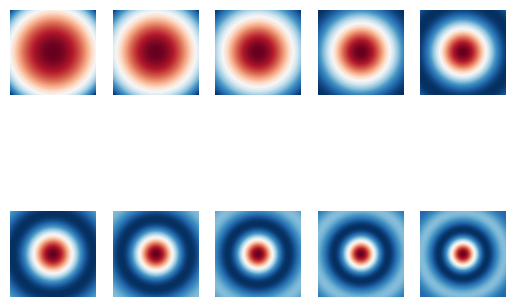

In [ ]:
num_basis = 10
cutoff = 4

basis = tg.nn.models.dimenet.BesselBasisLayer(num_basis, cutoff=cutoff)
x = torch.stack(torch.meshgrid(torch.linspace(-1, 1, 101), torch.linspace(-1, 1, 101)), dim=-1)
x_norm = torch.norm(x, dim=-1)
x_basis = basis(x_norm).detach()

cols = 5
rows = int(math.ceil(num_basis / 5))
fig, ax = plt.subplots(rows, cols)
for i in range(num_basis):
    r, c = divmod(i, 5)
    ax[r, c].imshow(x_basis[..., i], cmap='RdBu_r')
    ax[r, c].axis('off')
plt.show()

In [ ]:
def compute_gate_irreps(irreps_out):
    """Compute irreps_scalars, irreps"""
    irreps_scalars = Irreps([(mul, ir) for mul, ir in irreps_out if ir.l == 0])
    irreps_gated = Irreps([(mul, ir) for mul, ir in irreps_out if ir.l > 0])
    irreps_gates = Irreps([(mul, "0e") for mul, _ in irreps_gated]).simplify()

    return irreps_scalars, irreps_gated, irreps_gates

    
class Convolution(nn.Module):
    """ SE(3) equivariant convolution, parameterised by a radial network """
    def __init__(self, irreps_in1, irreps_in2, irreps_out):
        super().__init__()
        self.irreps_in1 = irreps_in1
        self.irreps_in2 = irreps_in2
        self.irreps_out = irreps_out
        self.tp =  o3.FullyConnectedTensorProduct(
            irreps_in1,
            irreps_in2,
            irreps_out,
            irrep_normalization="component",
            path_normalization="element",
            internal_weights=False,
            shared_weights=False
        )

        self.radial_net = RadialNet(self.tp.weight_numel)

    def forward(self, x, rel_pos_sh, distance):
        """
        Features of shape [E, irreps_in1.dim]
        rel_pos_sh of shape [E, irreps_in2.dim]
        distance of shape [E, 1]
        """
        weights = self.radial_net(distance)
        return self.tp(x, rel_pos_sh, weights)

class RadialNet(nn.Module):
    def __init__(self, num_weights):
        super().__init__()

        num_basis = 10
        basis = tg.nn.models.dimenet.BesselBasisLayer(num_basis, cutoff=4)

        self.net = nn.Sequential(basis,
                                nn.Linear(num_basis, 16),
                                nn.SiLU(),
                                nn.Linear(16, num_weights))
    def forward(self, dist):
        return self.net(dist.squeeze(-1))


class ConvLayerSE3(tg.nn.MessagePassing):
    def __init__(self, irreps_in1, irreps_in2, irreps_out, activation=True):
        super().__init__(aggr="add")

        self.irreps_in1 = irreps_in1
        self.irreps_in2 = irreps_in2
        self.irreps_out = irreps_out

        irreps_scalars, irreps_gated, irreps_gates = compute_gate_irreps(irreps_out)
        self.conv = Convolution(irreps_in1, irreps_in2, irreps_gates + irreps_out)

        if activation:
            self.gate = Gate(irreps_scalars, [nn.SiLU()], irreps_gates, [nn.Sigmoid()], irreps_gated)
        else:
            self.gate = nn.Identity()

    def forward(self, edge_index, x, rel_pos_sh, dist):
        x = self.propagate(edge_index, x=x, rel_pos_sh=rel_pos_sh, dist=dist)
        x = self.gate(x)
        return x

    def message(self, x_j, rel_pos_sh, dist):
        return self.conv(x_j, rel_pos_sh, dist)

class ConvModel(nn.Module):
    def __init__(self, irreps_in, irreps_hidden, irreps_edge, irreps_out, depth, max_z=10):
        super().__init__()

        self.irreps_in = irreps_in
        self.irreps_hidden = irreps_hidden
        self.irreps_edge = irreps_edge
        self.irreps_out = irreps_out

        self.embedder = nn.Embedding(max_z, irreps_in.dim)

        self.layers = nn.ModuleList()
        self.layers.append(ConvLayerSE3(irreps_in, irreps_edge, irreps_hidden))
        for i in range(depth-2):
            self.layers.append(ConvLayerSE3(irreps_hidden, irreps_edge, irreps_hidden))
        self.layers.append(ConvLayerSE3(irreps_hidden, irreps_edge, irreps_out, activation=False))


    def forward(self, graph):
        edge_index = graph.edge_index
        z = graph.z
        pos = graph.pos
        batch = graph.batch

        # Prepare quantities for convolutional layers
        src, tgt = edge_index[0], edge_index[1]
        rel_pos = pos[tgt] - pos[src]
        rel_pos_sh = o3.spherical_harmonics(self.irreps_edge, rel_pos, normalize=True)
        dist = torch.linalg.vector_norm(rel_pos, dim=-1, keepdims=True)

        x = self.embedder(z)
        # Let's go!
        for layer in self.layers:
            x = layer(edge_index, x, rel_pos_sh, dist)

        # Global pooling
        x = tg.nn.global_add_pool(x, batch)
        return x

For MD17, we will use steerable graph convolution network to predict the potential at each atom and take the gradient to get the force components. Then the sum of the potentials will be equal to the total energy, up to a constant term. The loss we optimise is

\begin{equation}
    L = |\hat{E} - E|^2 + \lambda_F \frac{1}{3N} \sum_{i=1}^N \sum_{\alpha=1}^3 \left| \hat{F}_{i, \alpha} + \frac{\partial E}{\partial r_{i, \alpha}} \right|^2
\end{equation}

We weigh the force and energy losses using the factor $\lambda_F$. Furthermore, we shift the energy to have zero mean and scale energy and force by the root mean square of the force magnitude.

The following code implements all relevant training details.

In [ ]:
class MD17(pl.LightningModule):
    def __init__(
        self,
        model,
        lr,
        weight=1,
        shift=0,
        scale=1,
    ):
        super().__init__()
        self.model = model
        self.lr = lr

        self.weight = weight
        self.shift = shift
        self.scale = scale

        self.energy_train_metric = torchmetrics.MeanAbsoluteError()
        self.energy_valid_metric = torchmetrics.MeanAbsoluteError()
        self.energy_test_metric = torchmetrics.MeanAbsoluteError()
        self.force_train_metric = torchmetrics.MeanAbsoluteError()
        self.force_valid_metric = torchmetrics.MeanAbsoluteError()
        self.force_test_metric = torchmetrics.MeanAbsoluteError()

    def forward(self, graph):
        energy, force = self.pred_energy_and_force(graph)
        return energy, force

    def pred_energy_and_force(self, graph):
        graph.pos = torch.autograd.Variable(graph.pos, requires_grad=True)
        pred_energy = self.model(graph)

        sign = -1.0
        pred_force = (
            sign
            * torch.autograd.grad(
                pred_energy,
                graph.pos,
                grad_outputs=torch.ones_like(pred_energy),
                create_graph=True,
                retain_graph=True,
            )[0]
        )
        return pred_energy.squeeze(-1), pred_force

    def energy_and_force_loss(self, graph, energy, force):
        loss = F.mse_loss(energy, (graph.energy - self.shift) / self.scale)
        loss = loss + self.weight * F.mse_loss(force, graph.force / self.scale)
        return loss

    def training_step(self, graph):
        energy, force = self(graph)
        loss = self.energy_and_force_loss(graph, energy, force)
        self.energy_train_metric(energy * self.scale + self.shift, graph.energy)
        self.force_train_metric(force * self.scale, graph.force)

        cur_lr = self.trainer.optimizers[0].param_groups[0]["lr"]
        self.log("lr", cur_lr, prog_bar=True, on_step=True)
        return loss

    def on_train_epoch_end(self):
        self.log("Energy train MAE", self.energy_train_metric, prog_bar=True)
        self.log("Force train MAE", self.force_train_metric, prog_bar=True)

    @torch.inference_mode(False)
    def validation_step(self, graph, batch_idx):
        energy, force = self(graph)
        self.energy_valid_metric(energy * self.scale + self.shift, graph.energy)
        self.force_valid_metric(force * self.scale, graph.force)

    def on_validation_epoch_end(self):
        self.log("Energy valid MAE", self.energy_valid_metric, prog_bar=True)
        self.log("Force valid MAE", self.force_valid_metric, prog_bar=True)

    def test_step(self, graph, batch_idx):
        energy, force = self(graph)
        self.energy_test_metric(energy * self.scale + self.shift, graph.energy)
        self.force_test_metric(force * self.scale, graph.force)

    def on_test_epoch_end(self):
        self.log("Energy test MAE", self.energy_test_metric, prog_bar=True)
        self.log("Force test MAE", self.force_test_metric, prog_bar=True)

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.lr)

        num_steps = self.trainer.estimated_stepping_batches
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_steps)

        lr_scheduler_config = {
            "scheduler": scheduler,
            "interval": "step",
            "frequency": 1,
        }
        return [optimizer], [lr_scheduler_config]

In [ ]:
num_features = 32
l_max = 3
depth = 3

irreps_in = (Irreps("1x0e")*num_features).simplify()
irreps_hidden = (Irreps.spherical_harmonics(l_max)*num_features).sort()[0].simplify()
irreps_edge = Irreps.spherical_harmonics(l_max)
irreps_out = Irreps("1x0e")

print("Input irreps", irreps_in)
print("Hidden irreps", irreps_hidden)
print("Edge irreps", irreps_edge)
print("Output irreps", irreps_out)
print("Dim hidden irreps:", irreps_hidden.dim)

model = ConvModel(irreps_in, irreps_hidden, irreps_edge, irreps_out, depth)
print()
print(model)
print(model.layers[0].conv)

Input irreps 32x0e
Hidden irreps 32x0e+32x1o+32x2e+32x3o
Edge irreps 1x0e+1x1o+1x2e+1x3o
Output irreps 1x0e
Dim hidden irreps: 512


/usr/local/lib/python3.10/dist-packages/torch/jit/_check.py:172: UserWarning:

The TorchScript type system doesn't support instance-level annotations on empty non-base types in `__init__`. Instead, either 1) use a type annotation in the class body, or 2) wrap the type in `torch.jit.Attribute`.




ConvModel(
  (embedder): Embedding(10, 32)
  (layers): ModuleList(
    (0-2): 3 x ConvLayerSE3()
  )
)
Convolution(
  (tp): FullyConnectedTensorProduct(32x0e x 1x0e+1x1o+1x2e+1x3o -> 128x0e+32x1o+32x2e+32x3o | 7168 paths | 7168 weights)
  (radial_net): RadialNet(
    (net): Sequential(
      (0): BesselBasisLayer(
        (envelope): Envelope()
      )
      (1): Linear(in_features=10, out_features=16, bias=True)
      (2): SiLU()
      (3): Linear(in_features=16, out_features=7168, bias=True)
    )
  )
)


In [ ]:
epochs = 100
lr = 1e-3
F_weight = 500
radius = 2
batch_size = 5

In [ ]:
# Let's load the datasets.
class Kcal2meV:
    def __init__(self):
        # Kcal/mol to meV
        self.conversion = 43.3634

    def __call__(self, graph):
        graph.energy = graph.energy * self.conversion
        graph.force = graph.force * self.conversion
        return graph

transform = tg.transforms.Compose([
    tg.transforms.RadiusGraph(radius),
    Kcal2meV(),
])

train_dataset = tg.datasets.MD17("data", name="aspirin CCSD", train=True, transform=transform)
train_dataset, valid_dataset = torch.utils.data.random_split(train_dataset, [950, 50], generator=torch.Generator().manual_seed(42))
test_dataset = tg.datasets.MD17("data", name="aspirin CCSD", train=False, transform=transform)

dataloaders = {
    "train": tg.loader.DataLoader(train_dataset, batch_size=batch_size, shuffle=True),
    "valid": tg.loader.DataLoader(valid_dataset, batch_size=batch_size),
    "test": tg.loader.DataLoader(test_dataset, batch_size=batch_size),
}

Extracting data/aspirin CCSD/raw/aspirin_ccsd.zip
Processing...
Done!


In [ ]:
N_nodes = 0
shift = 0
scale = 0
for graph in train_dataset:
    shift += graph.energy
    scale += torch.linalg.vector_norm(graph.force, dim=1).sum()
    N_nodes += graph.num_nodes

shift = (shift/len(train_dataset)).item()
scale = (scale/N_nodes).item()

print("Shift:", shift)
print("Scale:", scale)

Shift: -17591926.0
Scale: 2018.620361328125


In [ ]:
task = MD17(model, lr, F_weight, shift, scale)
trainer = pl.Trainer(max_epochs=epochs)
trainer.fit(task, dataloaders["train"], dataloaders["valid"])

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loading `train_dataloader` to estimate number of stepping batches.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name                | Type              | Params
----------------------------------------------------------
0 | model               | ConvModel         | 734 K 
1 | energy_train_metric | MeanAbsoluteError | 0     
2 | energy_valid_metric | MeanAbsoluteError | 0     
3 | energy_test_metric  | MeanAbsoluteError | 0     
4 | force_train_metric  | MeanAbsoluteError | 0     
5 | force_valid_metric  | MeanAbsoluteError | 0     
6 | f

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning:

Detected KeyboardInterrupt, attempting graceful shutdown...



### **Conclusion**
We hope that you have enjoyed this tutorial and that we have given you some insight into how you can utilise geometric information in manifold graphs. It goes without saying that we have only scratched the surface of the possibilities of including geometric information into graph neural networks. You can check out some of the references on the top of this notebook for further reading. 

Kind regards, 

Putri & Rob